<a href="https://colab.research.google.com/github/Priyanka-Prabhath/Recommendation-engine-for-online-retail-company/blob/main/Women_Dress_Recommendation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%matplotlib inline
from zipfile import ZipFile
import pandas as pd
import os
import random
import shutil
from pathlib import Path
import urllib.request
import shutil
import pickle
import cv2
from google.colab.patches import cv2_imshow
from numpy import expand_dims
from keras.callbacks import ModelCheckpoint
from keras.models import load_model
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import ImageDataGenerator
from matplotlib import pyplot
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
import keras
import matplotlib.pyplot as plt
from keras.models import Model
import cv2
from keras.datasets import cifar10
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import models, layers
from  keras.models import Model
from  keras.layers import BatchNormalization, Activation, Flatten
from  keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator

from sklearn.metrics.pairwise import pairwise_distances
from google.colab.patches import cv2_imshow
import warnings
warnings.filterwarnings("ignore")
! pip install scipy==0.19.1
from vis.visualization import visualize_activation
from vis.utils import utils
from keras import activations
from keras import applications
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = (18,6)

Using TensorFlow backend.


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [ ]:
from numpy.random import seed
seed(1)
from tensorflow import set_random_seed
set_random_seed(2)

# Download Zip 

In [ ]:
# extracting each Image into assignment
with ZipFile('/content/gdrive/My Drive/greendeck/assignment.zip', 'r') as zipObj:
   # Extract all the contents of zip file in current directory
   zipObj.extractall()

# Download Images from Url's

This is a Working Code<br>
But if we are trying to download Images from URL's into PATH- IT TAKES LONG TIME

In [ ]:
# creating a path-object for the current_directory
PATH = Path('/content')
# creating a assignment_url object folder to store all the downloaded images
os.mkdir('/content/assignment_url')

#### Function to download Images from URL's(takes long time to download- Try Extracting Images rather)

In [ ]:
def download_image(url):
    # split the single-url and and the last string after splitting  which is the Image-Name of downloaded image
    filename = url.split('/')[-1]
    # store the image-name
    fullname = str(filename)
    # download the image from URl-given with the following filename to the image
    urllib.request.urlretrieve(url,fullname)   
    #move the image to the following path-assignment_url
    shutil.move(PATH/fullname, PATH/'assignment_url/'/fullname )

In [ ]:

import requests
import urllib
from tqdm import tqdm

# map download_image to each element in the df['image_url']
map(download_image, list(df['image_url']))

In [ ]:
# can use above one to download images to assignment_url
for i in tqdm(range(df.shape[0])):
  link_url = df['image_url'][i]
  download_image(link_url)

# Read The Images-csv file as a Dataframe 

In [ ]:
# lading the Dataframe which contains Image-Path 
# Image_url which requires url to download image
# Category of that particular Image
df = pd.read_csv('/content/gdrive/My Drive/greendeck/dress_patterns.csv')

In [ ]:
df.head()

,_unit_id,category,category:confidence,image_url
0,851505458,ikat,0.3487,http://s3-eu-west-1.amazonaws.com/we-attribute...
1,851505459,plain,1.0000,http://s3-eu-west-1.amazonaws.com/we-attribute...
2,851505460,polka dot,0.6709,http://s3-eu-west-1.amazonaws.com/we-attribute...
3,851505461,plain,1.0000,http://s3-eu-west-1.amazonaws.com/we-attribute...
4,851505462,geometry,0.7035,http://s3-eu-west-1.amazonaws.com/we-attribute...


In [ ]:
df['image_url'][0]

'http://s3-eu-west-1.amazonaws.com/we-attributes/dress/23/5f635c0fa59f4270a6953f67dcddcda3.jpg.png'

In [ ]:
df.shape

(15702, 4)

In [ ]:
df['image_url'][0].split('/')[-1].split('.')[0] +'.png'

'5f635c0fa59f4270a6953f67dcddcda3.png'

# creating Train-Dataframe which contains image Path and Image-Category


In [ ]:
df.head()

,_unit_id,category,category:confidence,image_url
0,851505458,ikat,0.3487,http://s3-eu-west-1.amazonaws.com/we-attribute...
1,851505459,plain,1.0000,http://s3-eu-west-1.amazonaws.com/we-attribute...
2,851505460,polka dot,0.6709,http://s3-eu-west-1.amazonaws.com/we-attribute...
3,851505461,plain,1.0000,http://s3-eu-west-1.amazonaws.com/we-attribute...
4,851505462,geometry,0.7035,http://s3-eu-west-1.amazonaws.com/we-attribute...


In [ ]:
df['path'] =0

#### extracting Image_path from the dataframe

In [ ]:
from tqdm import tqdm
#  Extracting The image Path from Dataframe
for i  in tqdm(range(df.shape[0])):
  # extract the path of Image from filename of the image
  df['path'][i] =  str(df['image_url'][i].split('/')[-1].split('.')[0]) +'.png'

100%|██████████| 15702/15702 [00:02<00:00, 5760.52it/s]


In [ ]:
df.head()

,_unit_id,category,category:confidence,image_url,path
0,851505458,ikat,0.3487,http://s3-eu-west-1.amazonaws.com/we-attribute...,5f635c0fa59f4270a6953f67dcddcda3.png
1,851505459,plain,1.0000,http://s3-eu-west-1.amazonaws.com/we-attribute...,ca5ca27caca94f9fb0617c226477ae35.png
2,851505460,polka dot,0.6709,http://s3-eu-west-1.amazonaws.com/we-attribute...,7be73e354249484db5a8ddf4e05cc63b.png
3,851505461,plain,1.0000,http://s3-eu-west-1.amazonaws.com/we-attribute...,7e241481162649d39048f522d0653e03.png
4,851505462,geometry,0.7035,http://s3-eu-west-1.amazonaws.com/we-attribute...,808d0bf9fe9745fca13ab461f86e0e4e.png


In [ ]:
from keras import backend as K
K.clear_session()

In [ ]:
%matplotlib inline

# Data Augmentation 

In [ ]:
# train_generator for training
train_gen = ImageDataGenerator(
        vertical_flip=True,
        zoom_range=0.1,
        horizontal_flip=True,
        fill_mode='nearest')

In [ ]:
# valid_generator for Validation Data
valid_gen = ImageDataGenerator(
        vertical_flip=True,
        zoom_range=0.1,
        horizontal_flip=True,
        fill_mode='nearest')

# Model-custom Dense Networks Architecture using Dense Blocks

#### Creating Dense-Block's and Output-layer

In [ ]:
# Dense Block which concatenates channels of n th layer to (n+5)th layer
# Each dense Block contains l-ub-blocks
# In each sub-block first and lastlayer channel's are concatenated
def denseblock(input, num_filter = 28, dropout_rate = 0.25):
    global compression
    temp = input
    for _ in range(l): 
        BatchNorm = layers.BatchNormalization()(temp)
        relu = layers.Activation('relu')(BatchNorm)
        Conv2D_3_3 = layers.Conv2D(int(num_filter*compression), (3,3), use_bias=False ,padding='same')(relu)
        # using Dropout's 
        if dropout_rate>0:
            Conv2D_3_3 = layers.Dropout(dropout_rate)(Conv2D_3_3)
        # concatenate the channel's  of  first-input -(Temp-Layer) and  Last-(Conv2D_3_3)-layer
        concat = layers.Concatenate(axis=-1)([temp,Conv2D_3_3])
        # This last layer is the next inut ot the sub-block
        temp = concat
        
    return temp

# 
## transition Block for the BottleNeck of Channel's and also Average-Pooling 
def transition(input, num_filter = 28, dropout_rate = 0.25):
    global compression
    BatchNorm = layers.BatchNormalization()(input)
    relu = layers.Activation('relu')(BatchNorm)
    # creating Bottle-neck using (1,1)-filter's
    Conv2D_BottleNeck = layers.Conv2D(int(num_filter*compression), (1,1), use_bias=False ,padding='same')(relu)
    if dropout_rate>0:
         Conv2D_BottleNeck = layers.Dropout(dropout_rate)(Conv2D_BottleNeck)
    avg = layers.AveragePooling2D(pool_size=(2,2))(Conv2D_BottleNeck)
    return avg

#output layer-Final output Layer
def output_layer(input):
    global compression
    BatchNorm = layers.BatchNormalization()(input)
    relu = layers.Activation('relu')(BatchNorm)
    AvgPooling = layers.AveragePooling2D(pool_size=(2,2))(relu)
    flat = layers.Flatten()(AvgPooling)
    # final output Layer Softmax
    # at output -the no.of.units = no.of.classes
    output = layers.Dense(17, activation='softmax')(flat)
    return output

#### Hyperparameter's for Model

In [ ]:
# Hyperparameters
num_filter = 28
dropout_rate = 0.25
num_classes = 17
epochs = 10
l = 7
compression = 1

#### MODEL-architechture

In [ ]:
# input for the model
input = layers.Input(shape=(100,100, 3,))
# First COnv Layer
First_Conv2D = layers.Conv2D(64, (3,3), use_bias=False ,padding='same')(input)
# First Dense Block and Transition-Block
First_Block = denseblock(First_Conv2D, num_filter, dropout_rate)
First_Transition = transition(First_Block, num_filter, dropout_rate)
# Second Dense Block and Transition-Block
Second_Block = denseblock(First_Transition, num_filter, dropout_rate)
Second_Transition = transition(Second_Block, num_filter, dropout_rate)
# Third Dense Block and Transition-Block
Third_Block = denseblock(Second_Transition, num_filter, dropout_rate)
Third_Transition = transition(Third_Block, num_filter, dropout_rate)
# Last Dense BLock
Last_Block = denseblock(Third_Transition,  num_filter, dropout_rate)
# Second COnv-layer after all Dense and transition Blocks
second_conv2d = layers.Conv2D(128, (3,3), use_bias=False ,padding='same')(Last_Block)
# Output-Layer conatin the last layer with 17 neuron's with -No.of.Classes
output = output_layer(second_conv2d)












Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.



In [ ]:
model = Model(inputs=[input], outputs=[output])

In [ ]:
# compiling model using adam oprimizers and categorical cross-entropy
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])


In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 100, 100, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 100, 100, 64) 1728        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 100, 100, 64) 256         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 100, 100, 64) 0           batch_normalization_1[0][0]      
____________________________________________________________________________________________

#### path and Dataframe for train-Generator

In [ ]:
# input for the Data-Genrator's
train_generator = train_gen.flow_from_dataframe(
    # passing dataframe as input
        df,
        directory = '/content/assignment',
        x_col ='path',
        y_col= 'category',
        shuffle = True,
          # this is the target directory
        target_size=(100,100),  # all images will be resized to 150x150
        class_mode="categorical",
        # batch_size=32
        batch_size =32,
        seed=5
        )

Found 15702 validated image filenames belonging to 17 classes.


In [ ]:
# input for the valid-generator
valid_generator = valid_gen.flow_from_dataframe(
    # input for the valid_generator
        df,
        directory = '/content/assignment',
        x_col ='path',
        y_col= 'category',
        shuffle = True,
          # this is the target directory
        target_size=(100,100),  # all images will be resized to 150x150
        class_mode="categorical",
        batch_size =32,
        seed=5
        )

Found 15702 validated image filenames belonging to 17 classes.


#### creating a Model-Check-Point for storing the best validation_loss

In [ ]:
# creating a model checkpoint which monitirs the training Loss 
# Model stores the Parameters of Best Model which has low training-Loss
filepath = "/content/gdrive/My Drive/greendeck/weights_full_train-{epoch:02d}-{val_acc:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

#### Loading the best_model-parameters

In [ ]:
model = load_model('/content/gdrive/My Drive/greendeck/weights_full_train-40-0.91.hdf5')










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.



Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where




#### Training the Model - Interrupted Manually after we get the Best parameters for the Validation_data


In [ ]:
STEP_SIZE_TRAIN=(train_generator.n//train_generator.batch_size +1)
STEP_SIZE_VALID=(valid_generator.n//valid_generator.batch_size +1)
model.fit_generator(generator=train_generator,
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    validation_data=valid_generator,
                    validation_steps=STEP_SIZE_VALID,
                    epochs=75,
                              callbacks=callbacks_list)

Epoch 1/75
491/491 [==============================] - 332s 677ms/step - loss: 0.3462 - acc: 0.8826 - val_loss: 0.6478 - val_acc: 0.8305

Epoch 00001: val_loss did not improve from 0.37642
Epoch 2/75
491/491 [==============================] - 330s 673ms/step - loss: 0.3456 - acc: 0.8785 - val_loss: 2.1546 - val_acc: 0.6218

Epoch 00002: val_loss did not improve from 0.37642
Epoch 3/75
491/491 [==============================] - 338s 689ms/step - loss: 0.3565 - acc: 0.8771 - val_loss: 0.3410 - val_acc: 0.8924

Epoch 00003: val_loss improved from 0.37642 to 0.34095, saving model to /content/gdrive/My Drive/greendeck/weights_full_train-03-0.89.hdf5
Epoch 4/75
491/491 [==============================] - 340s 692ms/step - loss: 0.3533 - acc: 0.8805 - val_loss: 0.5823 - val_acc: 0.8372

Epoch 00004: val_loss did not improve from 0.34095
Epoch 5/75
491/491 [==============================] - 340s 692ms/step - loss: 0.3547 - acc: 0.8782 - val_loss: 0.6825 - val_acc: 0.8295

Epoch 00005: val_loss d

KeyboardInterrupt: ignored

# Predicting The output

In [ ]:
model.evaluate_generator(valid_generator,steps=491,verbose=1)

491/491 [==============================] - 194s 396ms/step


[0.2638339966349565, 0.9140236912267464]

In [ ]:
# Resetting the valid-generator
valid_generator.reset()
# Taking the output's of model 
# pred gives us a output 17-dim Vector
pred=model.predict_generator(valid_generator,steps=491,verbose=1)

491/491 [==============================] - 175s 355ms/step


In [ ]:
pred.shape

(15702, 17)

#### Dictionary which contains Class-Label's and Class-Encoding for that class

In [ ]:
# labels contain the classes
labels = (valid_generator.class_indices)
labels

{'OTHER': 0,
 'animal': 1,
 'cartoon': 2,
 'chevron': 3,
 'floral': 4,
 'geometry': 5,
 'houndstooth': 6,
 'ikat': 7,
 'letter_numb': 8,
 'plain': 9,
 'polka dot': 10,
 'scales': 11,
 'skull': 12,
 'squares': 13,
 'stars': 14,
 'stripes': 15,
 'tribal': 16}

In [ ]:
# labels contain classes which contain key is class_id and value is class
labels = dict((v,k) for k,v in labels.items())
labels

{0: 'OTHER',
 1: 'animal',
 2: 'cartoon',
 3: 'chevron',
 4: 'floral',
 5: 'geometry',
 6: 'houndstooth',
 7: 'ikat',
 8: 'letter_numb',
 9: 'plain',
 10: 'polka dot',
 11: 'scales',
 12: 'skull',
 13: 'squares',
 14: 'stars',
 15: 'stripes',
 16: 'tribal'}

In [ ]:
# list_calsses contain list of classs
list_classes = list(labels.values())

# Output_Layer-Matrix(last Layer representation of each Image)

In [ ]:
# We store the Last layer Representation of Image in the output_layer matrix
import numpy as np
output_layer_matrix = np.zeros((df.shape[0],17))

In [ ]:
df['prediction_label'] = 0

In [ ]:
# load the Image
from tqdm import tqdm
output_labels = []
for i in tqdm(range(len(list(df['path'])))):

  image = cv2.imread('/content/assignment/' + df['path'][i])
  image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
#resize image to appropriate dimensions
  image = cv2.resize(image,(100,100))
  image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
  output_layer_matrix[i] = model.predict(image)[0]
  output_labels.append(list(np.argmax(model.predict(image),axis=1))[0])

100%|██████████| 15702/15702 [05:31<00:00, 47.36it/s]


In [ ]:
df['prediction_label'] = [labels[output_labels[i]] for i in range(len(output_labels))]

In [ ]:
output_layer_matrix.shape

(15702, 17)

# saving results to CSV

In [ ]:
# create a DF with filenames, Prediction's and also Actual category of that image
df.head()

,_unit_id,category,category:confidence,image_url,path,prediction_label
0,851505458,ikat,0.3487,http://s3-eu-west-1.amazonaws.com/we-attribute...,5f635c0fa59f4270a6953f67dcddcda3.png,ikat
1,851505459,plain,1.0000,http://s3-eu-west-1.amazonaws.com/we-attribute...,ca5ca27caca94f9fb0617c226477ae35.png,plain
2,851505460,polka dot,0.6709,http://s3-eu-west-1.amazonaws.com/we-attribute...,7be73e354249484db5a8ddf4e05cc63b.png,squares
3,851505461,plain,1.0000,http://s3-eu-west-1.amazonaws.com/we-attribute...,7e241481162649d39048f522d0653e03.png,plain
4,851505462,geometry,0.7035,http://s3-eu-west-1.amazonaws.com/we-attribute...,808d0bf9fe9745fca13ab461f86e0e4e.png,geometry


# Confusion Matrix,Precision Matrix, Recall Matrix

Precision matrix says of all those images predicted of class-(X) how many Images Actually belong to that particular class-(X)<br>
We could also assume that How many Images of Class-(X)  are wrongly predicted

Recall matrix says of all those images actually belong  of class-(X)... how many Images are  Predicted belong to that particular class-(X)<br>
We could also assume that How many Images of Class-(X)  are Missing

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix 
import seaborn as sns
def plot_confusion_matrix(test_y, predict_y):
    C = confusion_matrix(test_y, predict_y)
    
    # C = 17,17 matrix, each cell (i,j) represents number of points of class i are predicted class j
    
    A =(((C.T)/(C.sum(axis=1))).T)
    #divid each element of the confusion matrix with the sum of elements in that column
    
    # C = [[1, 2],
    #     [3, 4]]
    # C.T = [[1, 3],
    #        [2, 4]]
    # C.sum(axis = 1)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =1) = [[3, 7]]
    # ((C.T)/(C.sum(axis=1))) = [[1/3, 3/7]
    #                           [2/3, 4/7]]

    # ((C.T)/(C.sum(axis=1))).T = [[1/3, 2/3]
    #                           [3/7, 4/7]]
    # sum of row elements = 1
    
    B =(C/C.sum(axis=0))
    #divid each element of the confusion matrix with the sum of elements in that row
    # C = [[1, 2],
    #     [3, 4]]
    # C.sum(axis = 0)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =0) = [[4, 6]]
    # (C/C.sum(axis=0)) = [[1/4, 2/6],
    #                      [3/4, 4/6]] 
    # Confusion matrix
    labels = list_classes
    cmap=sns.light_palette("red")
    # representing A in heatmap format
    print("-"*50, "Confusion matrix", "-"*50)
    plt.figure(figsize=(17,17))
    sns.heatmap(C, annot=True, cmap=cmap, fmt='d',xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.show()
    
    # PRECISION MATRIX
    print("-"*50, "Precision matrix", "-"*50)
    cmap=sns.light_palette("green")
    plt.figure(figsize=(17,17))
    sns.heatmap(B, annot=True, cmap=cmap, fmt=".2g", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.show()
    print("Sum of columns in precision matrix",B.sum(axis=0))
    
    # RECALL MATRIX
    # representing B in heatmap format
    print("-"*50, "Recall matrix"    , "-"*50)
    cmap=sns.light_palette("blue")
    plt.figure(figsize=(17,17))
    sns.heatmap(A, annot=True, cmap=cmap, fmt=".2g", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.show()
    print("Sum of rows in precision matrix",A.sum(axis=1))
    # how many images are wrongly Predicted
    print("Number of misclassified points ",(len(test_y)-np.trace(C))/len(test_y)*100)

-------------------------------------------------- Confusion matrix --------------------------------------------------


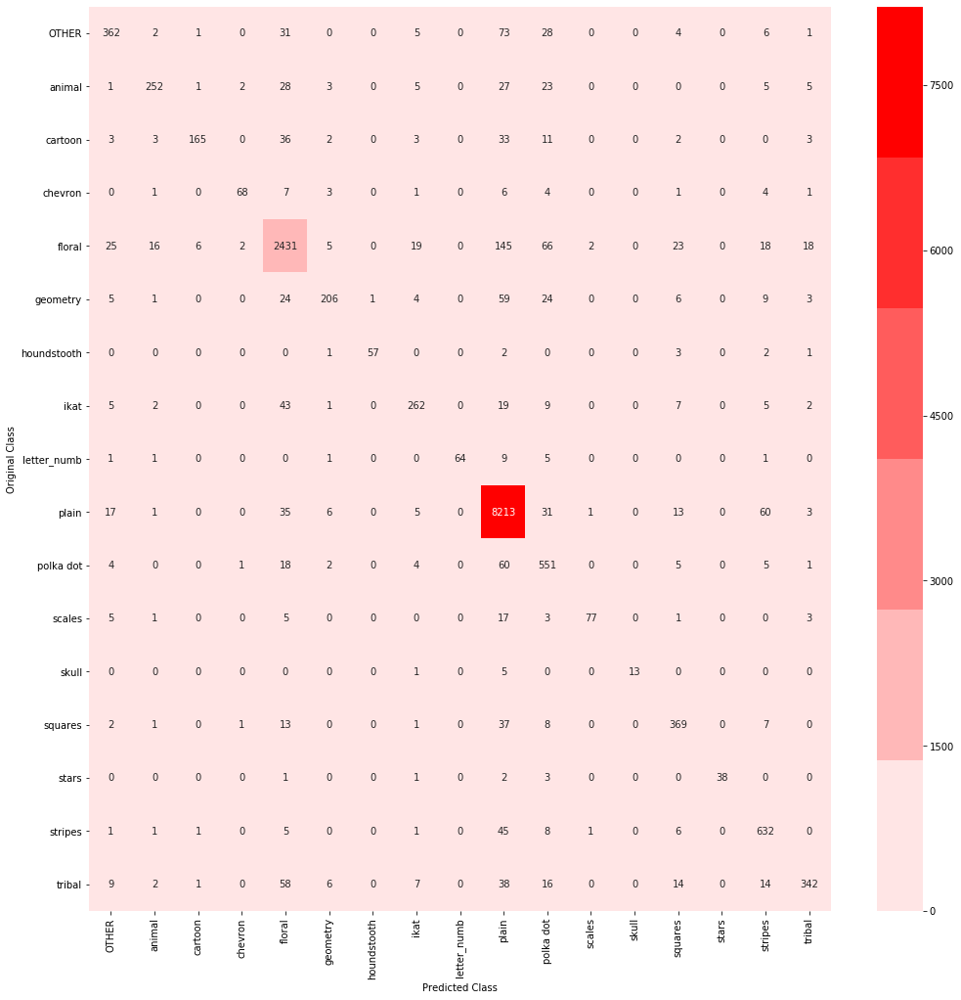

-------------------------------------------------- Precision matrix --------------------------------------------------


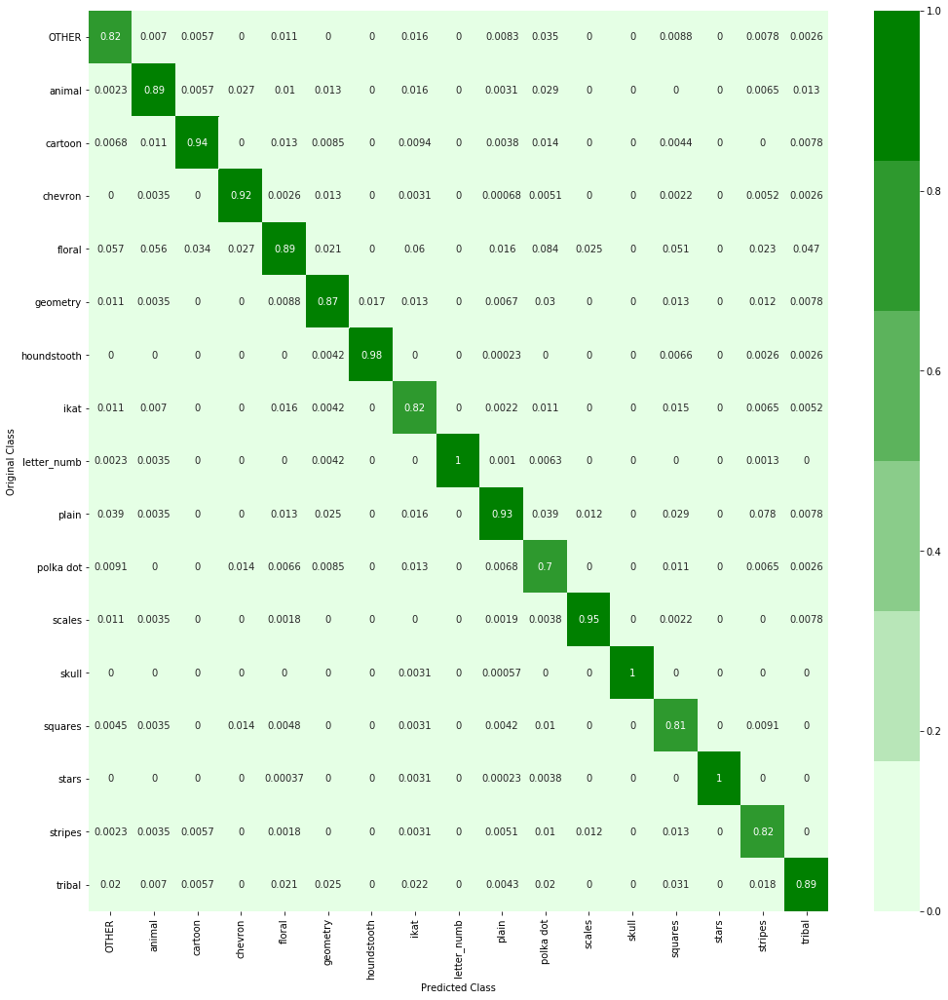

Sum of columns in precision matrix [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
-------------------------------------------------- Recall matrix --------------------------------------------------


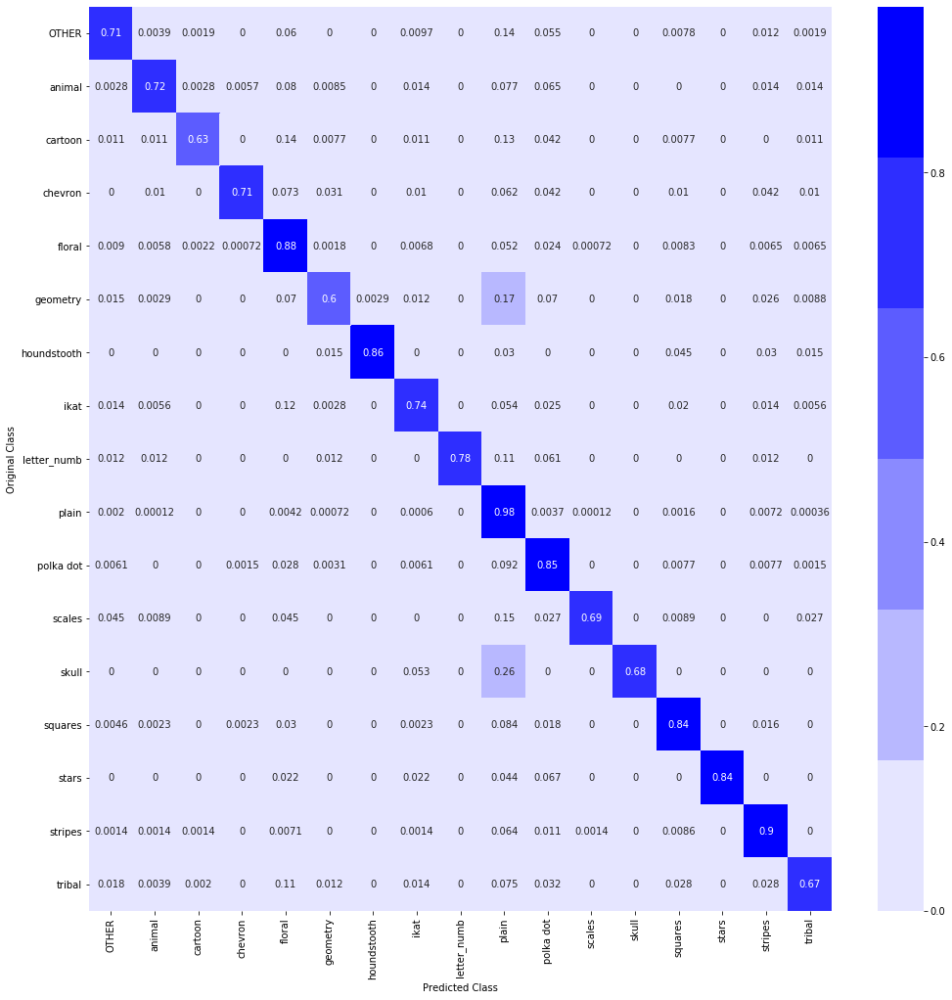

Sum of rows in precision matrix [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
Number of misclassified points  10.18978474079735


In [ ]:
plot_confusion_matrix(df['category'],df['prediction_label'])

# print the similar images belonging to that Image


#### Given a REAL_TIME-test image - Find the similar images to test Image

Images are Downloaded from Google

In [ ]:
# we are given a Input Image and Find the Similar images to Given Input Image
def Similar_products_path(path,num_products):
  
  image = cv2.imread(path)
  print('Input Image')
  
  
  image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
  #resize image to appropriate dimensions
  image = cv2.resize(image,(100,100))
  cv2_imshow(image)
  image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
  
  print("Input-Image-Class =",labels[list(np.argmax(model.predict(image),axis=1))[0]])
  output_layer_path = model.predict(image)[0]
  # take the similar of images based on Image_vector present in the Layer layer 
  # we stored representation of each image in the output_layer-MATRIX
  pairwise_dist = pairwise_distances(output_layer_matrix, output_layer_path.reshape(1,-1))
  # take the first 10 products  which are similar to the given image
  indices = np.argsort(pairwise_dist.flatten())[0:num_products]
  pdists  = np.sort(pairwise_dist.flatten())[0:num_products]
  print('Similar Images to given Input Image')
  for i in range(num_products):
    cv2_imshow(cv2.imread('/content/assignment/'+ list(df.loc[indices,'path'])[i]))
    print(df.loc[indices[i],'prediction_label'])

Input Image


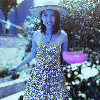

Input-Image-Class = floral
Similar Images to given Input Image


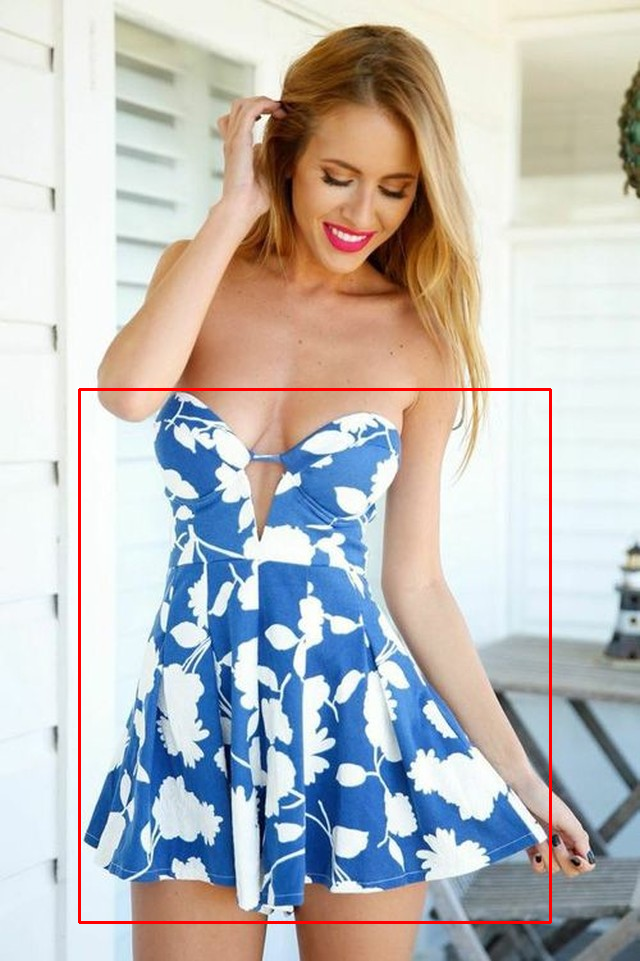

floral


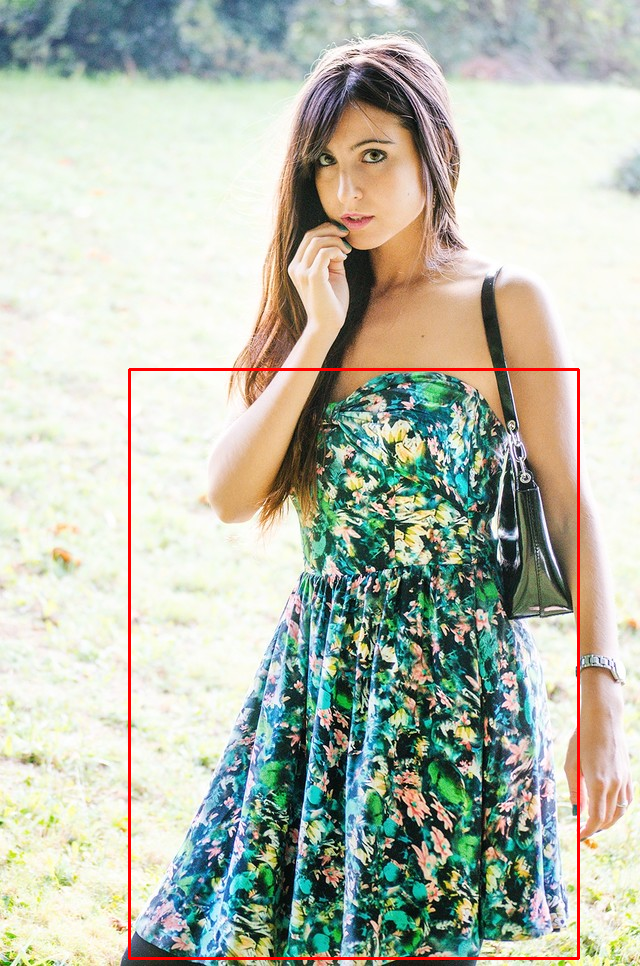

floral


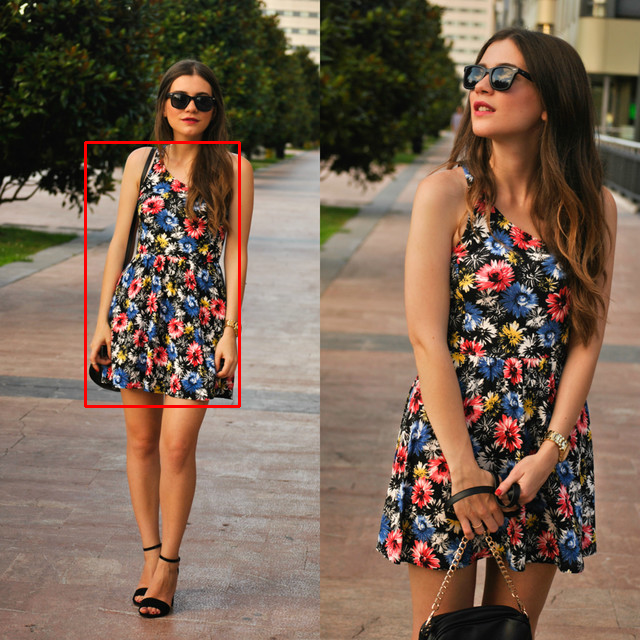

floral


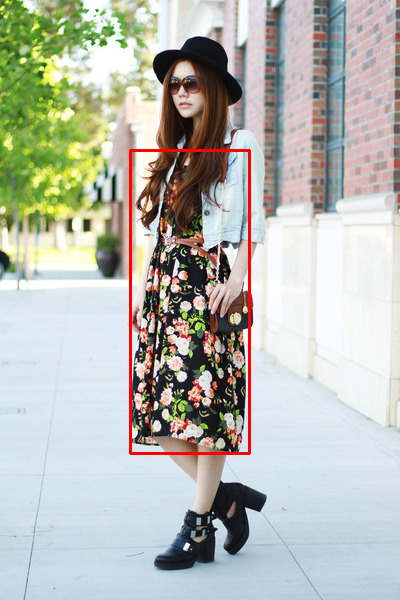

floral


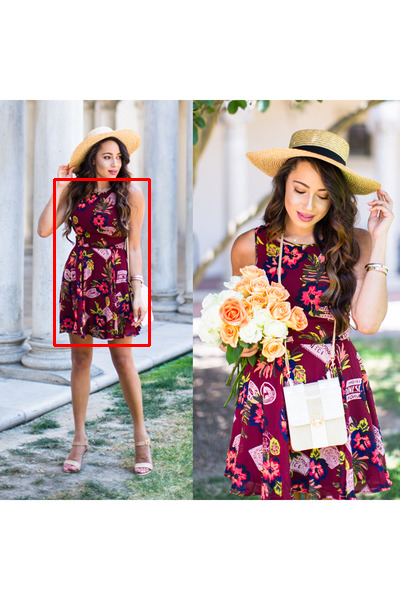

floral


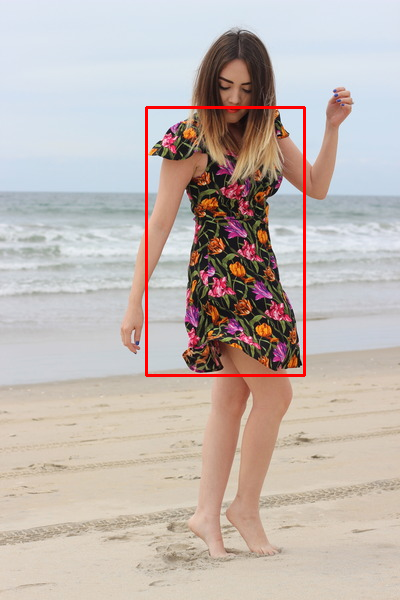

floral


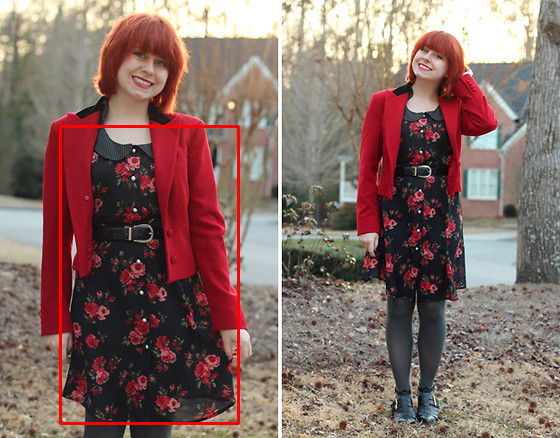

floral


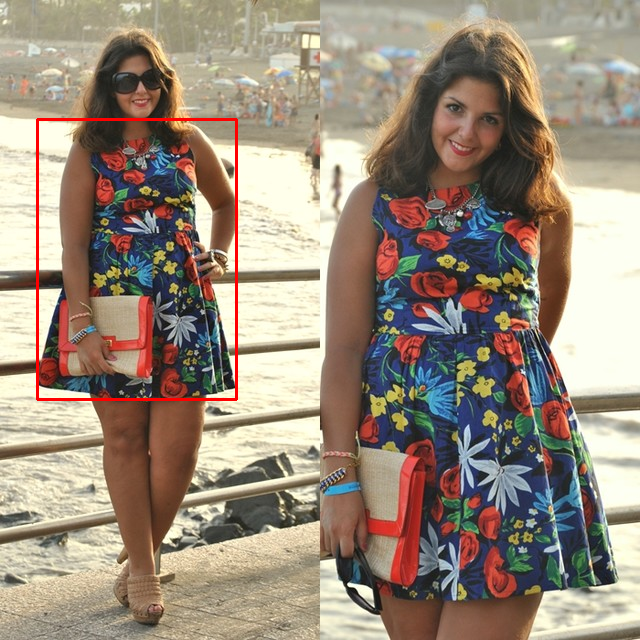

floral


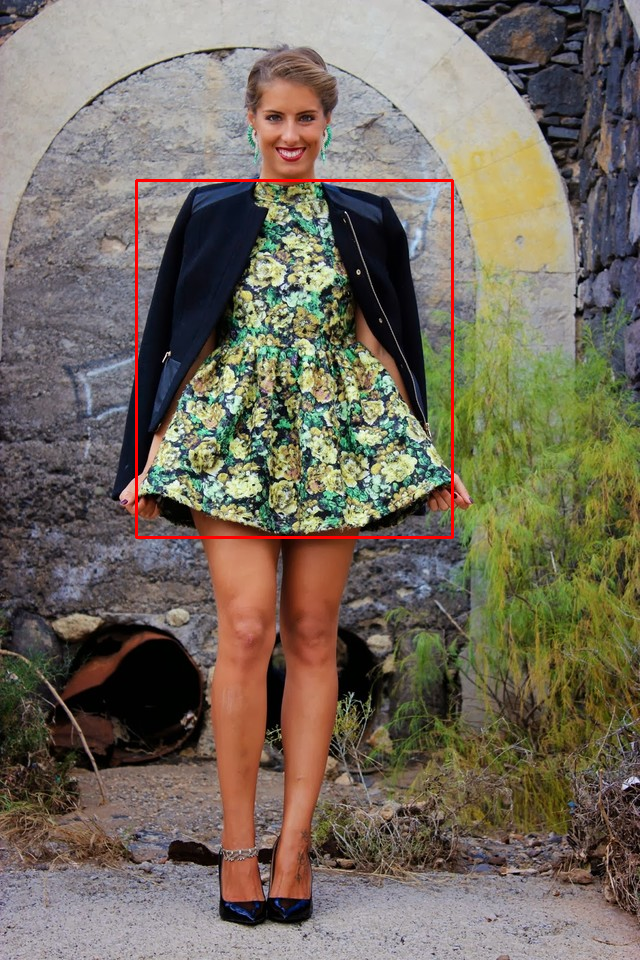

floral


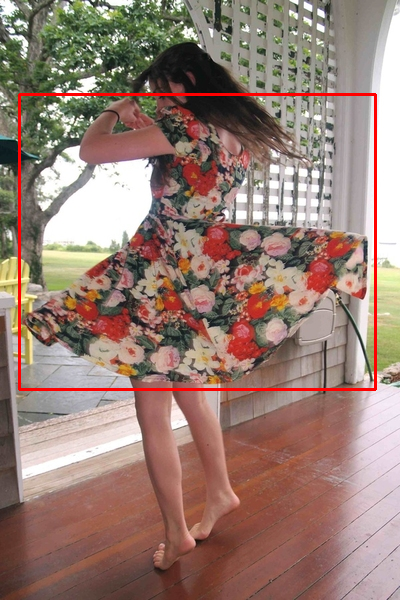

floral


In [ ]:
Similar_products_path('/content/floral_image.jpg',10)

Input Image


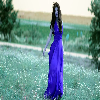

Input-Image-Class = plain
Similar Images to given Input Image


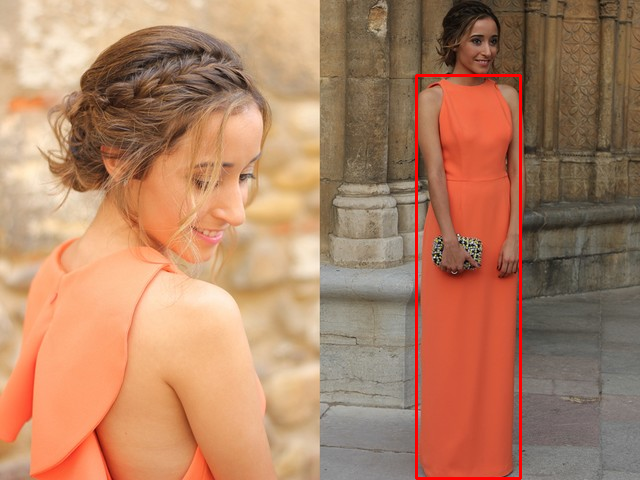

plain


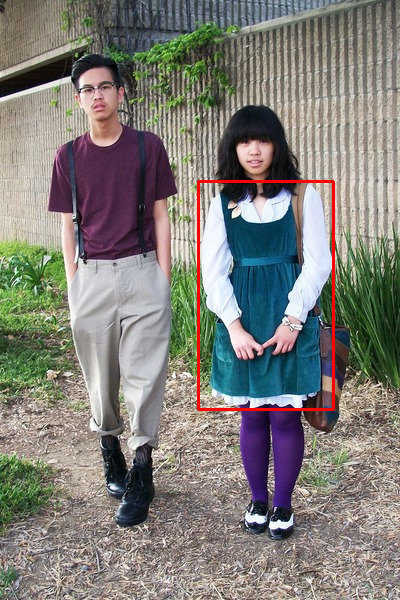

plain


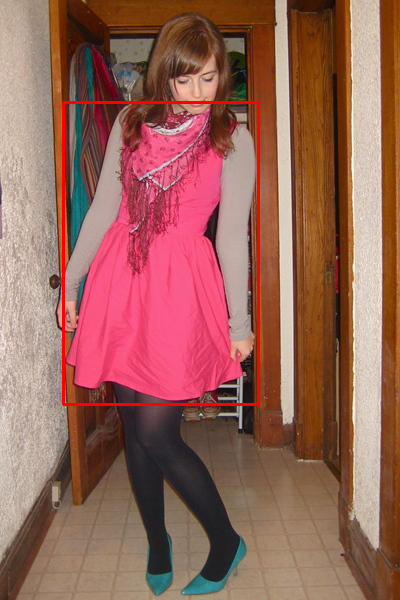

plain


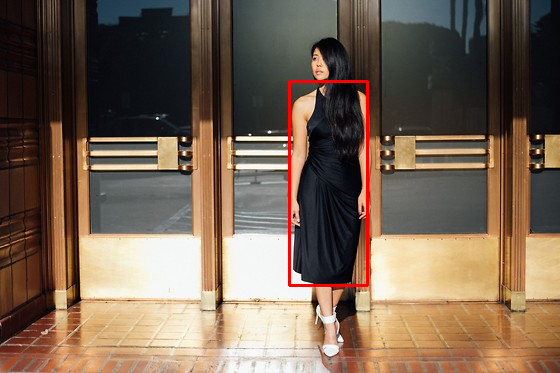

plain


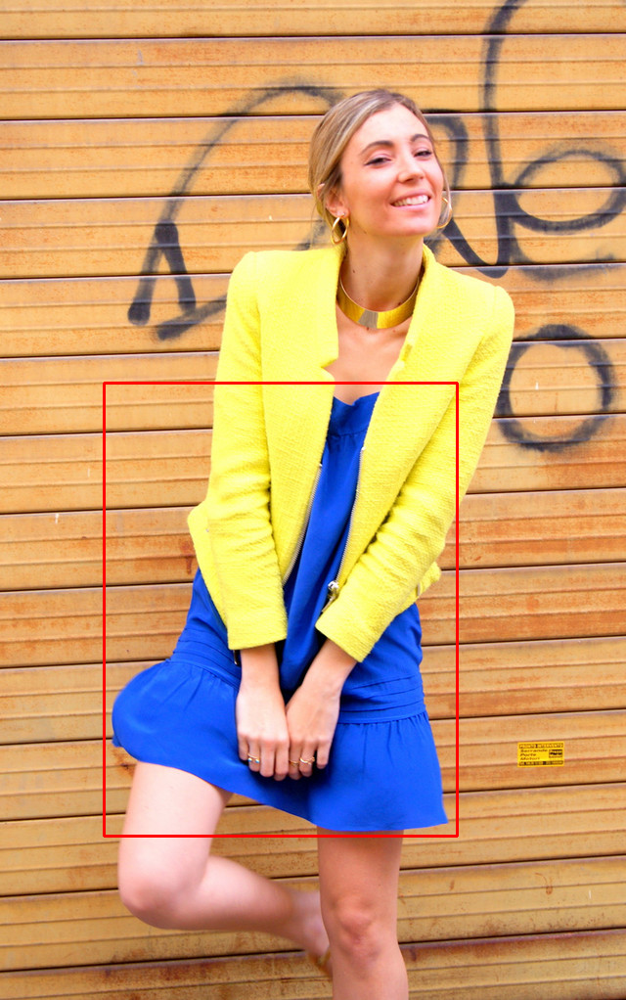

plain


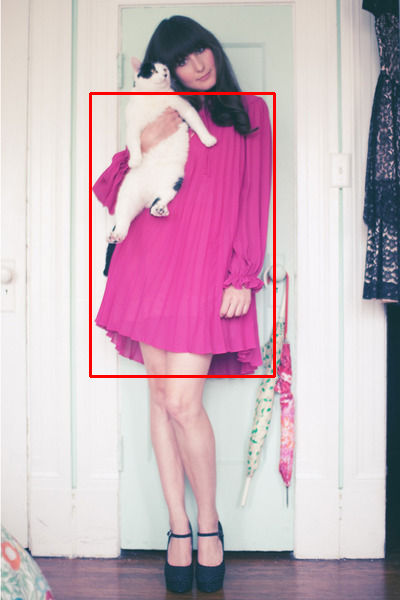

plain


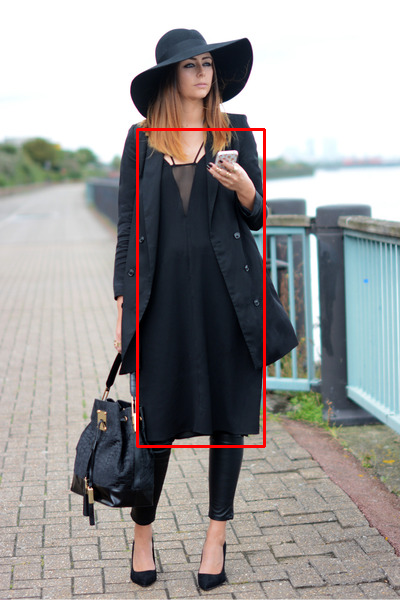

plain


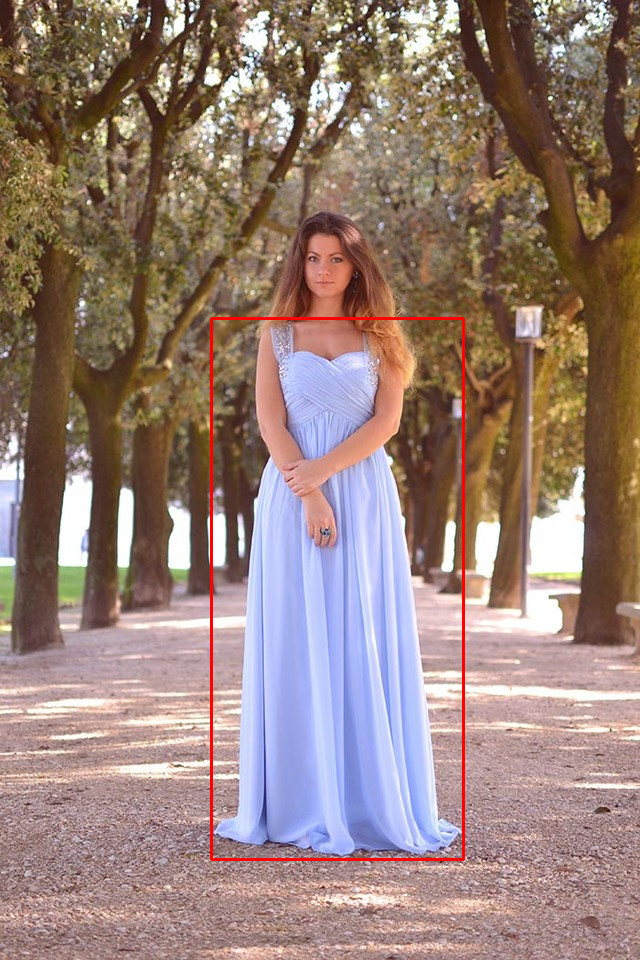

plain


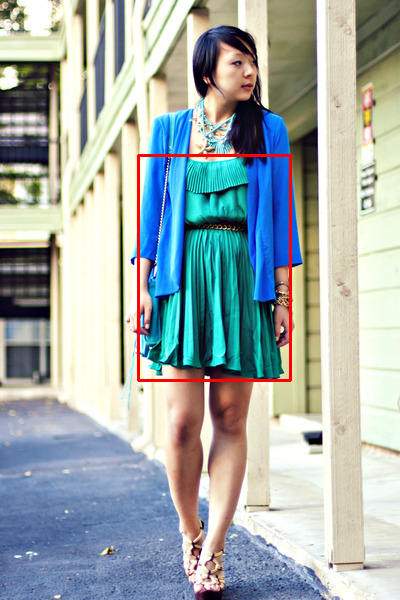

plain


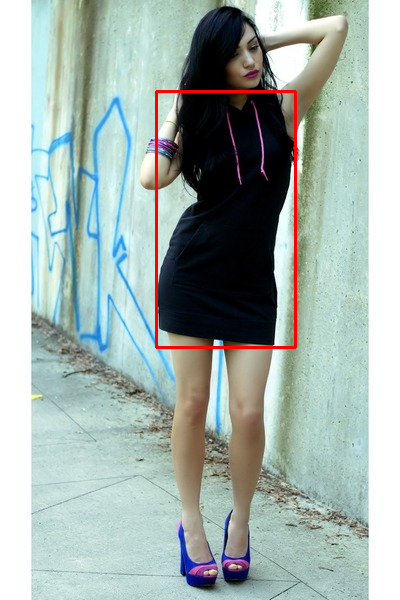

plain


In [ ]:
Similar_products_path('/content/plain.jpg',10)

#### Given a Image from train-set find similar images to the given Image

In [ ]:
def Similar_products(image_index,num_products):

  
  # take the similar of images based on Image_vector present in the Layer layer 
  # we stored representation of each image in the output_layer-MATRIX
  pairwise_dist = pairwise_distances(output_layer_matrix, output_layer_matrix[image_index].reshape(1,-1))
  # take the first 10 products  which are similar to the given image
  indices = np.argsort(pairwise_dist.flatten())[0:num_products]
  pdists  = np.sort(pairwise_dist.flatten())[0:num_products]
  print('Similar Images to given Input Image')
  for i in range(num_products):
    cv2_imshow(cv2.imread('/content/assignment/'+ list(df.loc[indices,'path'])[i]))
    print(df.loc[indices[i],'prediction_label'])

Similar Images to given Input Image


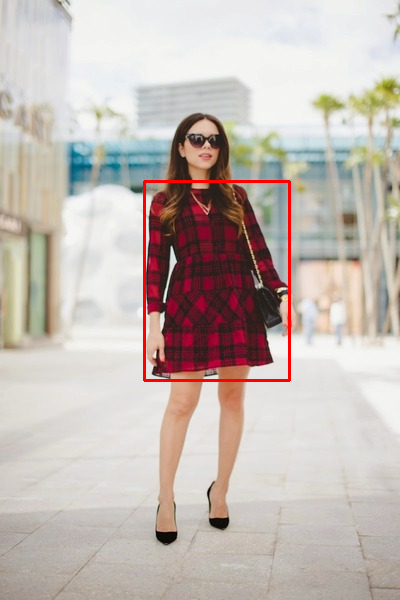

squares


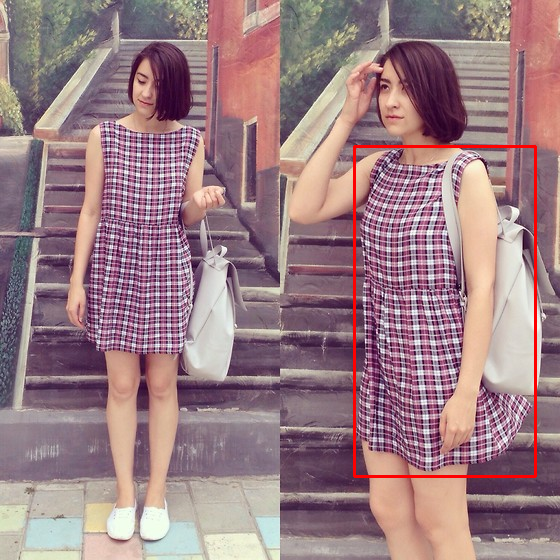

squares


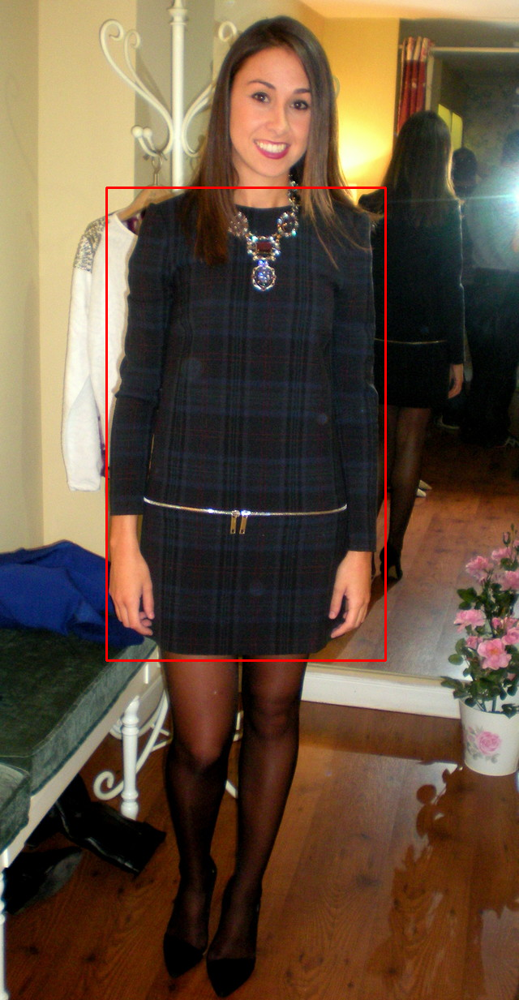

squares


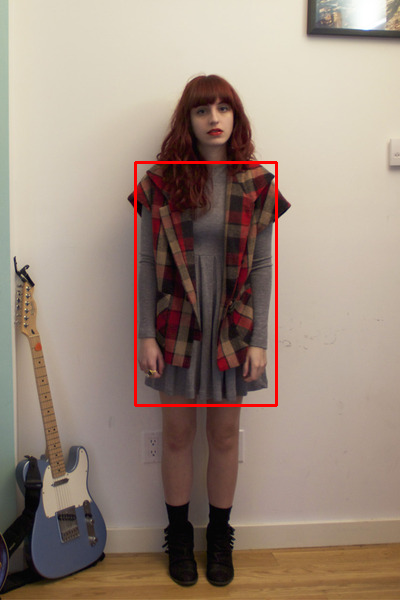

squares


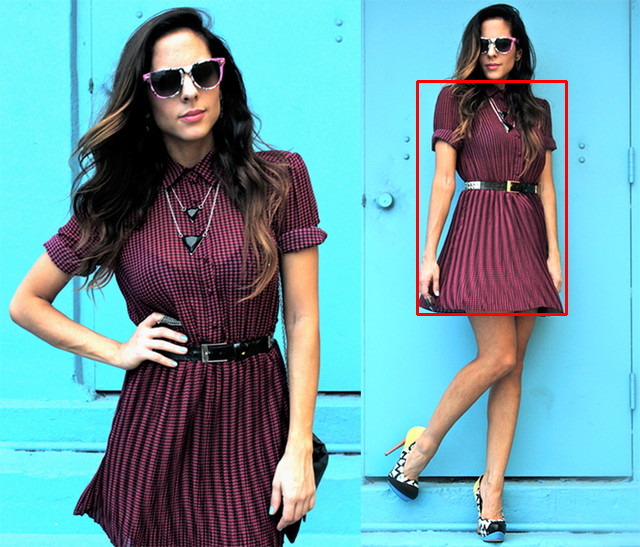

squares


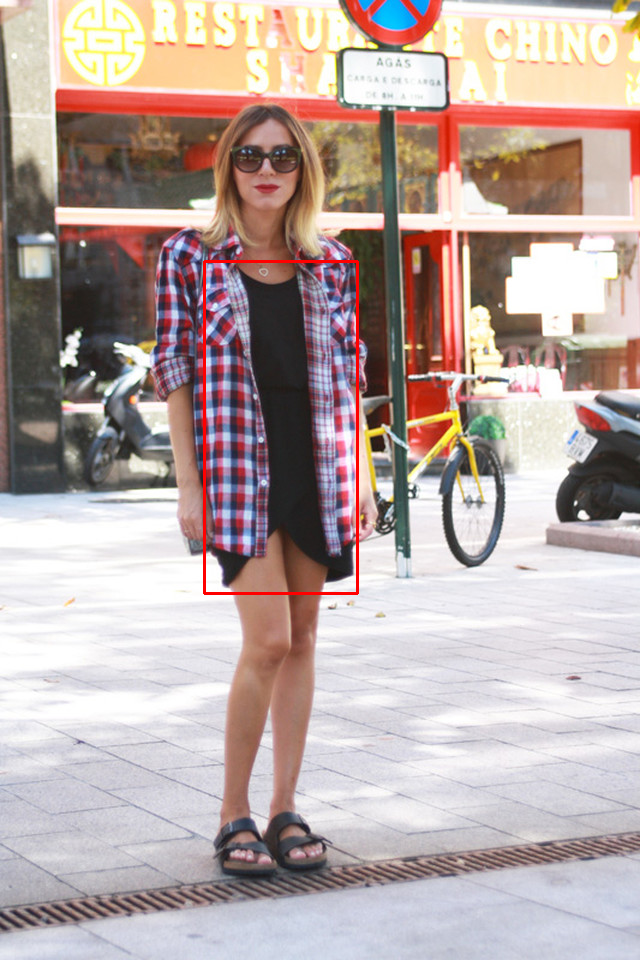

squares


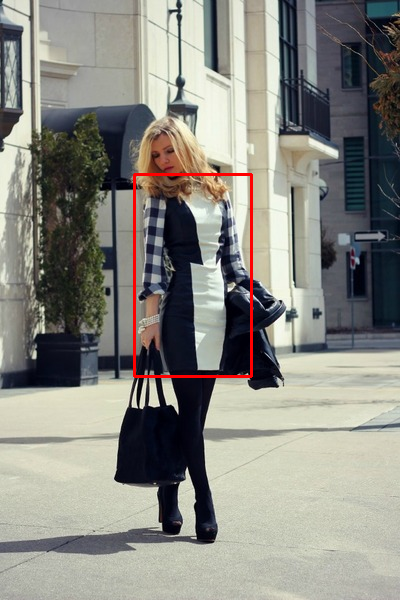

squares


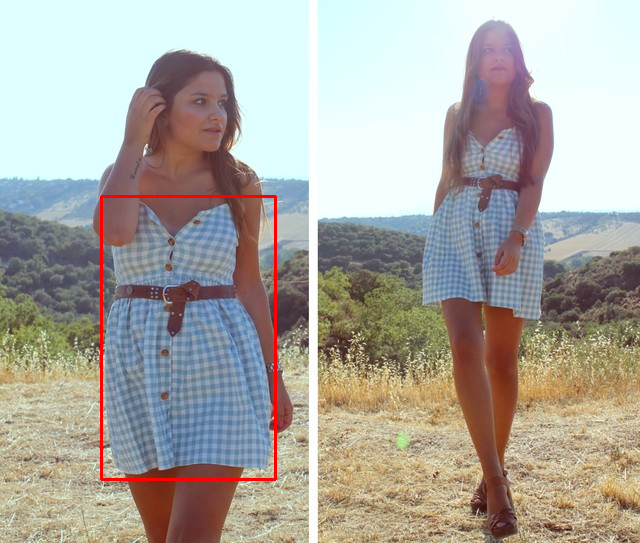

squares


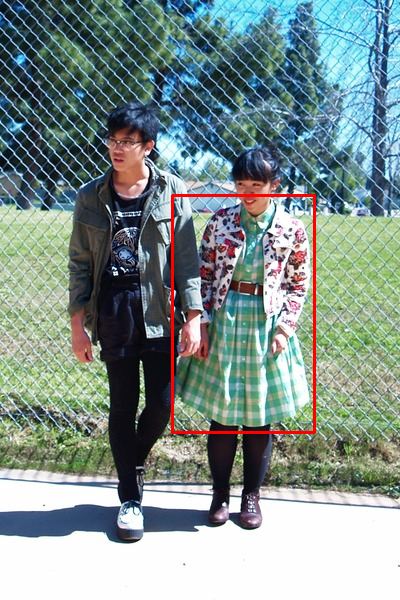

squares


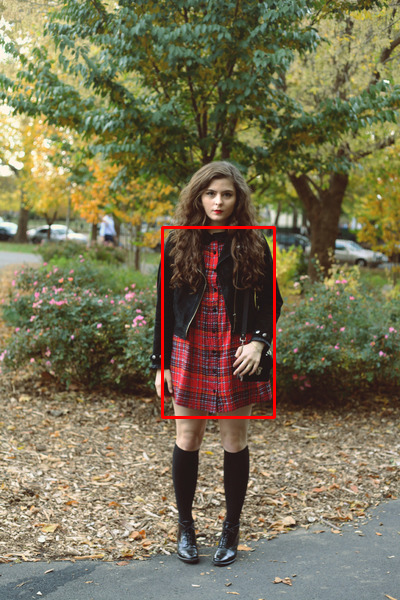

squares


In [ ]:
# the first Image is the given input Image and other Images are Similar Image given index
# generates a random Number from the train Images and print similar images to the Given input-1st Image
Similar_products(random.randrange(0,df.shape[0]),10)

# what the Model is Seeing - Visualising and Understanding from Images

In [ ]:
# contain the layer-names
layers_info = {}
for i in model.layers:
    layers_info[i.name] = i.get_config()

In [ ]:

model.layers[64]

#### which parts of Convolutions are activated for a particular Filter in a Particular Layer

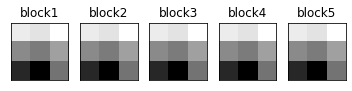

In [ ]:
# model-layer
layers = model.layers
# Index of that particular Index
layer_ids = [64,114,94,14, 4]
#plot the filters
fig,ax = plt.subplots(nrows=1,ncols=5)
for i in range(5):
    # take a particular filter and get their weights and Visualize the Filter 
    # we are taking only one filter which is a gray-scale image
    # we could see which parts of filter are activated
    ax[i].imshow(layers[layer_ids[0]].get_weights()[0][:,:,:,0][:,:,0],cmap='gray')
    ax[i].set_title('block'+str(i+1))
    ax[i].set_xticks([])
    ax[i].set_yticks([])

#### Load the Input Image

In [ ]:
import cv2

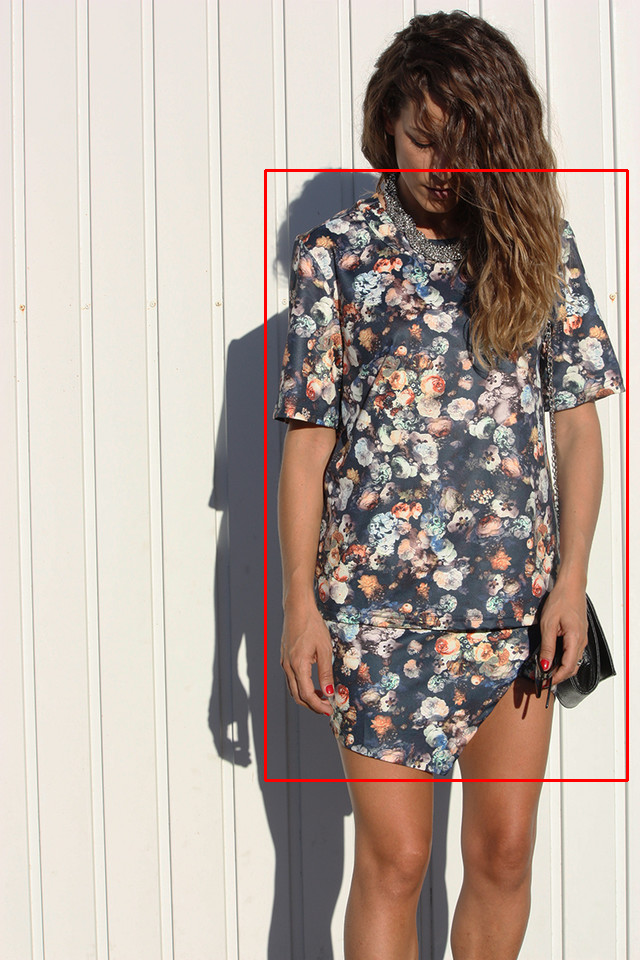

In [ ]:
# load the Image
image = cv2.imread('/content/00073f06539e4dd7b81f6009eedbcae3.png')
cv2_imshow(image)
image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
#resize image to appropriate dimensions

image = cv2.resize(image,(100,100))

#### Visualize the output at particular Layer of a respective Image

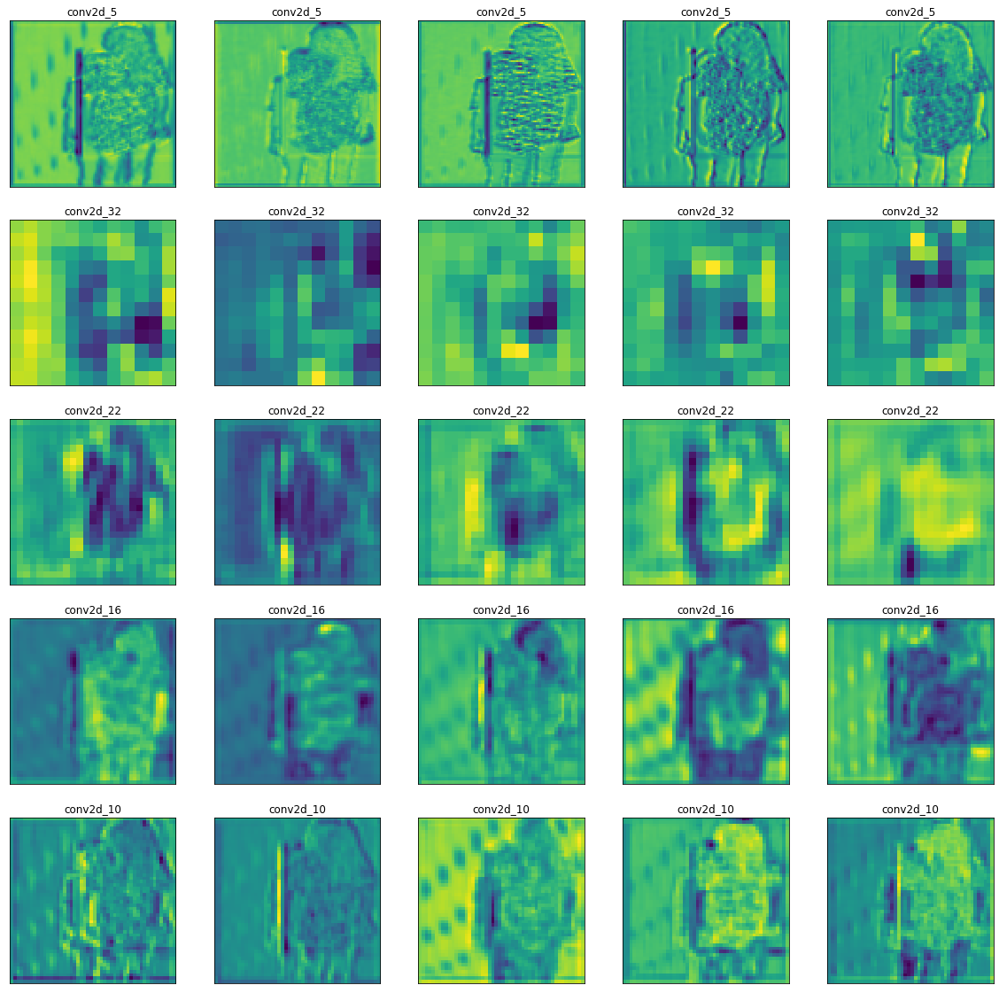

In [ ]:
# layer's names
layer_names = ['conv2d_5','conv2d_32','conv2d_22','conv2d_16','conv2d_10']
outputs = []
image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
#extracting the output and appending to outputs
for layer_name in layer_names:
    # model input = Image , output = values at that particular layer= (activation's * previous_pixel's)
    intermediate_layer_model = Model(inputs=model.input,outputs=model.get_layer(layer_name).output)
    # predict the output for one-image
    intermediate_output = intermediate_layer_model.predict(image)
    # append the output's for each layer 
    # we visualise them later
    outputs.append(intermediate_output)
#plotting the outputs
fig,ax = plt.subplots(nrows=5,ncols=5,figsize=(20,20))

for i in range(5):
    for z in range(5):
        # we are taking the fifth filter and we need to visualize them
        ax[i][z].imshow(outputs[i][0,:,:,z])
        ax[i][z].set_title(layer_names[i])
        ax[i][z].set_xticks([])
        ax[i][z].set_yticks([])